# $Pancancer$

In [18]:
%load_ext autoreload
%autoreload 2

In [19]:
import anndata as ad
import numpy as np
import pandas as pd

from rich import print
import os

import scvi

import matplotlib.pyplot as plt
import seaborn as sns
import scanpy as sc
import colorcet as cc
scvi.settings.seed = 34

# Set SVG font type to 'none' to keep text as text in SVG files
plt.rcParams["svg.fonttype"] = "none"

Seed set to 34


In [20]:
from params import setup

In [21]:
sc.set_figure_params(dpi=150, fontsize=12, format="svg")

figure_dir = setup.FIGURES_FOLDER

plots = True

In [22]:
data_dir, data_file = setup.DATA_FOLDER, setup.DATA_FILE

data_file_name = os.path.splitext(data_file)[0]
print(data_file_name)


path_to_save = os.path.join("../../niche-VI-experiments/checkpoints", data_file_name)
os.makedirs(path_to_save, exist_ok=True)

pancancer_resolvi

In [23]:
adata = ad.read_h5ad(path_to_save + "/pancancer_resolvi_nicheVI.h5ad")

print(adata)

AnnData object with n_obs × n_vars = 10372964 × 550
    obs: 'transcript_id', 'x', 'y', 'z', 'observed_x', 'observed_y', 'observed_z', 'fov', 'probability', 
'background', 'confusion', 'patient', 'louvain', 'louvain_final', 'cell_type', 'cell_type_coarse', 'cluster', 
'_indices', '_scvi_batch', '_scvi_ind_x', '_scvi_labels', 'predicted_celltype', 'predicted_celltype_prob', 'index',
'_scvi_sample', 'organ', 'T_cell_to_Cancer', 'kmeans_alpha_2', 'kmeans_X_nicheVI_2'
    var: 'mean', 'std'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'log1p', 'neighbors', 'patient_colors', 'predicted_celltype_colors', 
'umap'
    obsm: 'X_resolvi', 'X_scanvi', 'X_spatial', 'X_umap', 'celltype_transfer', 'distance_neighbor', 
'index_neighbor', 'neighborhood_composition', 'niche_distances', 'niche_indexes', 'qz1_m_niche_ct', 'qz1_m_pred', 
's10_scanvi_lr0.0005_poisson_X_nicheVI', 'spatial'
    layers: 'counts', 'counts_log1p', 'counts_wo_bg', 'estimated_counts', 'min_max_scaled'
    obsp: 'connectivities', 'distances'

In [24]:
samples_organs = {
    "uterine": [
        "HumanUterineCancerPatient2-RACostain",
        "HumanUterineCancerPatient2-ROCostain",
        "HumanUterineCancerPatient1",
    ],
    "lung": ["HumanLungCancerPatient1", "HumanLungCancerPatient2"],
    "prostate": ["HumanProstateCancerPatient1", "HumanProstateCancerPatient2"],
    "colon": ["HumanColonCancerPatient1", "HumanColonCancerPatient2"],
    "ovarian": [
        "HumanOvarianCancerPatient1",
        "HumanOvarianCancerPatient2Slice1",
        "HumanOvarianCancerPatient2Slice2",
        "HumanOvarianCancerPatient2Slice3",
    ],
    "melanoma": ["HumanMelanomaPatient1", "HumanMelanomaPatient2"],
    "breast": ["HumanBreastCancerPatient1"],
    "liver": ["HumanLiverCancerPatient1", "HumanLiverCancerPatient2"],
}

# Create a sample-to-organ mapping from the samples_organs dictionary
sample_to_organ = {
    sample: organ for organ, samples in samples_organs.items() for sample in samples
}

# Map the `SAMPLE` column in `adata.obs` to the organ using sample_to_organ
adata.obs["organ"] = adata.obs[setup.SAMPLE].map(sample_to_organ)

# Define mapping for coarse cell types
celltype_mapping = {
    "Cancer Cell": "Cancer Cell",
    "Myofibroblast": "Myofibroblast",
    "T Cell": "T Cell",
    "Macrophage": "Macrophage",
    "B Cell": "B Cell",
    "Suppressive Macrophage": "Macrophage",  # Merging with Macrophage
    "Endothelial": "Endothelial",
    "Intestinal Epithelial Cell": "Epithelial",
    "Skin Epithelial Cell": "Epithelial",
}

# Apply mapping
adata.obs["celltype_coarse"] = adata.obs[setup.CELL_TYPE].map(celltype_mapping)

<Axes: title={'center': 'celltype_coarse'}, xlabel='UMAP1', ylabel='UMAP2'>

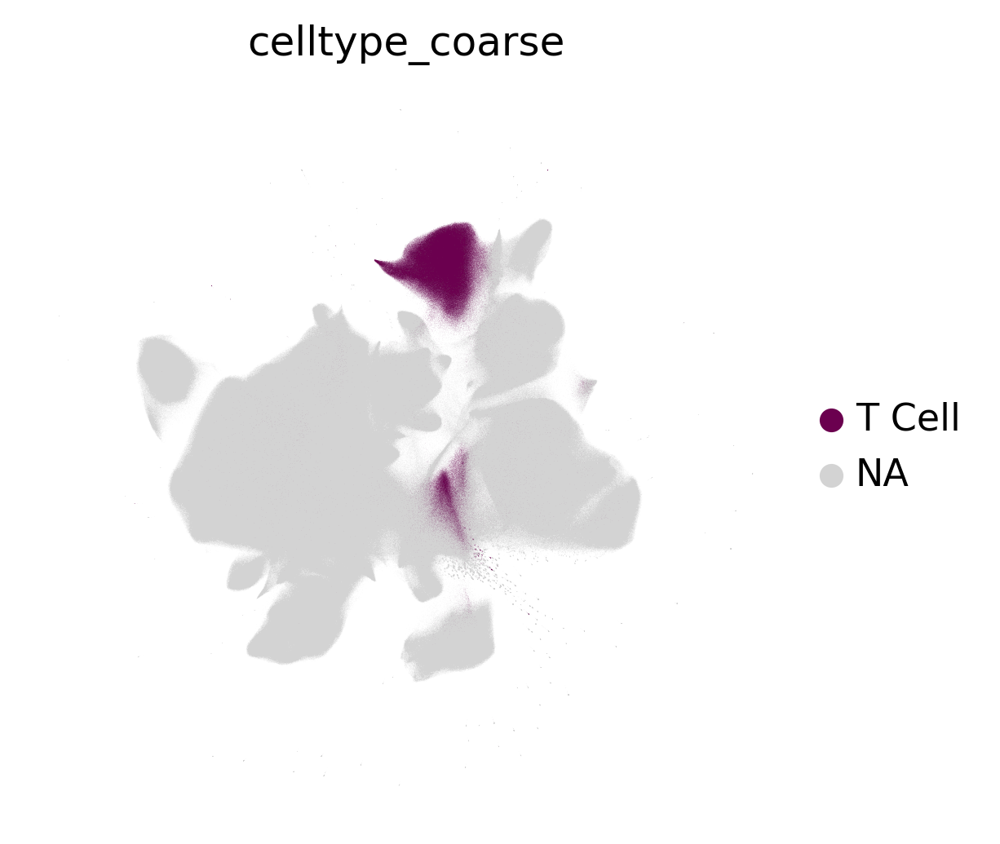

In [25]:
sc.pl.umap(
    adata,
    color=["celltype_coarse"],
    wspace=0.5,
    hspace=0.5,
    ncols=1,
    groups=["T Cell"],
    palette=cc.glasbey_dark,
    show=False,
    use_raw=False,
    frameon=False,
)
# plt.savefig(f"{figure_dir}/nicheVI_umap_with_Tcell.svg", dpi=500)

In [26]:
adata.obs['T cell annotation'] = 'other type'
adata.obs.loc[adata.obs['celltype_coarse'] == 'T Cell', 'T cell annotation'] = 'T cell low-quality'


adata_filtered_outliers = ad.read_h5ad(
    "../../niche-VI-experiments/checkpoints/pancancer_resolvi/pancancer_resolvi_nicheVI_T_Cell_filtered.h5ad"
)

adata_T_cell = adata[adata.obs[setup.CELL_TYPE] == "T Cell"]
diff_cells = adata_T_cell.obs.index.difference(adata_filtered_outliers.obs.index)
# adata_filtered_outliers.obs.index
adata.obs.loc[
    adata.obs.index.isin(adata_filtered_outliers.obs.index), "T cell annotation"
] = "T cell"

In [27]:
# Ensure "low-quality" is a valid category
adata.obs["celltype_coarse"] = adata.obs["celltype_coarse"].astype("category")
adata.obs["celltype_coarse"] = adata.obs["celltype_coarse"].cat.add_categories(
    ["low-quality"]
)

In [28]:
adata.obs.loc[diff_cells, "celltype_coarse"] = "low-quality"

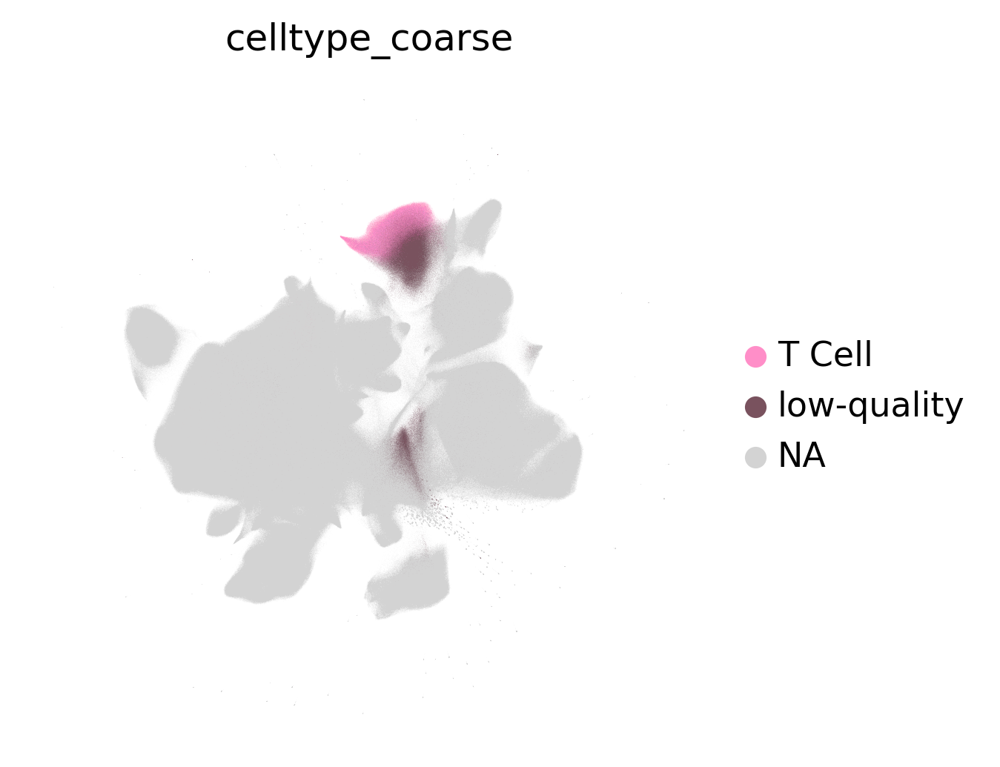

In [29]:
sc.pl.umap(
    adata,
    color=["celltype_coarse"],
    wspace=0.3,
    hspace=0.5,
    ncols=2,
    palette=cc.glasbey_light,
    groups=["T Cell", "low-quality"],
    frameon=False,
)

In [32]:
colors = ['red', 'lavender', 'green', 'hotpink', 'lime', 'tan', 'indigo', 'lightslategrey']

<Axes: title={'center': 'organ'}, xlabel='UMAP1', ylabel='UMAP2'>

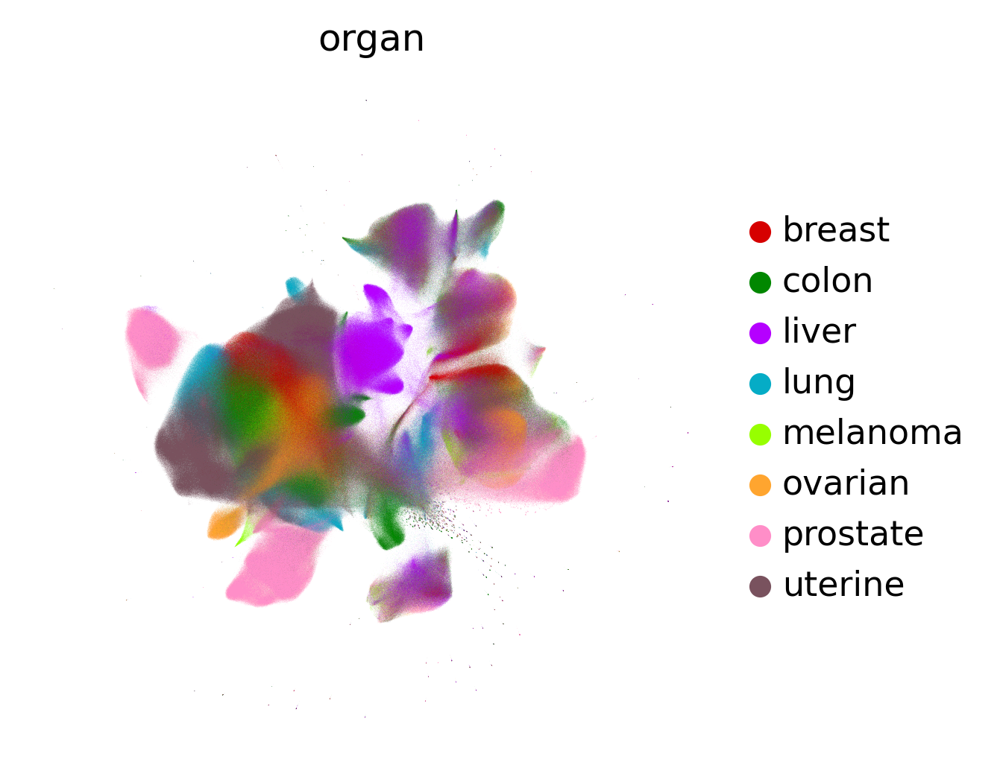

In [33]:
sc.pl.umap(adata, color=["organ"], wspace=0.3, hspace=0.5, ncols=2, palette=cc.glasbey_light, frameon=False, show=False)
# plt.savefig(f"{figure_dir}/nicheVI_umap_with_organ.svg", dpi=300)

<Axes: title={'center': 'celltype_coarse'}, xlabel='UMAP1', ylabel='UMAP2'>

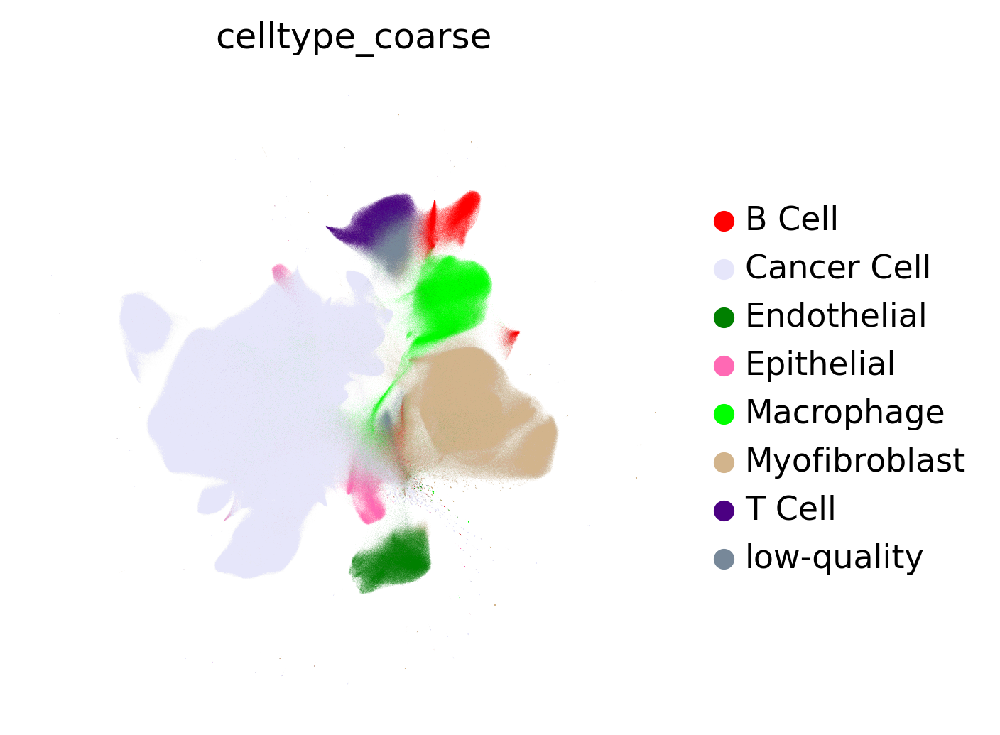

In [34]:
# sc.pl.umap(adata, color=['celltype_coarse', "organ"], wspace=0.3, hspace=0.5, ncols=2, palette=cc.glasbey_light, frameon=False)
sc.pl.umap(adata, color=['celltype_coarse'], wspace=0.3, hspace=0.5, ncols=2, palette=colors, frameon=False, show=False)
# plt.savefig(f"{figure_dir}/nicheVI_umap_with_celltypes.svg", dpi=300)

<Axes: title={'center': 'T cell annotation'}, xlabel='UMAP1', ylabel='UMAP2'>

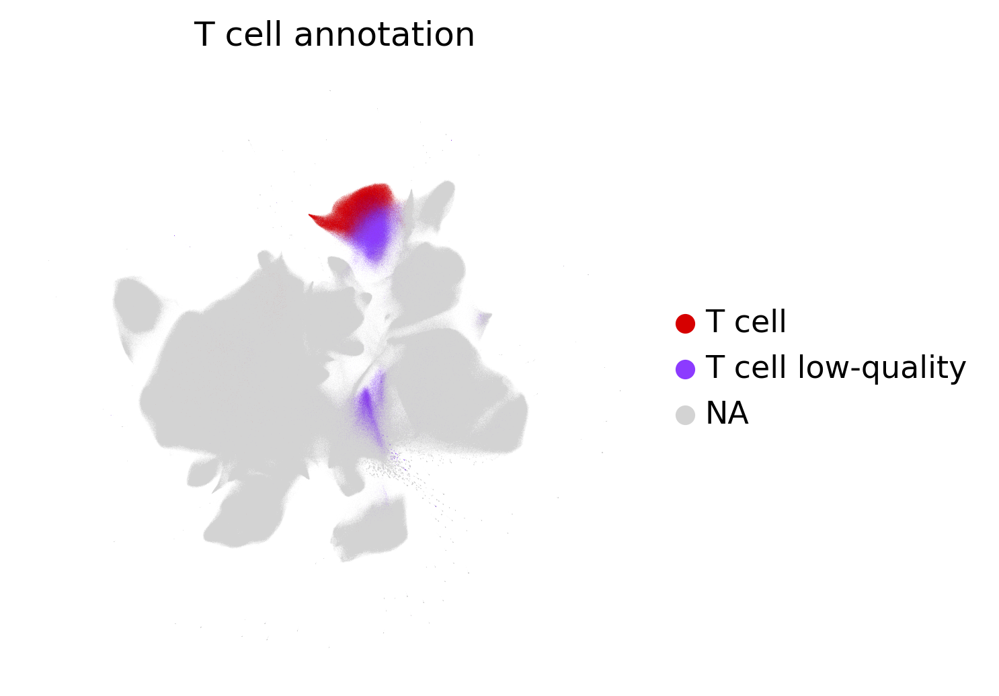

In [35]:
sc.pl.umap(
    adata,
    color=["T cell annotation"],
    wspace=0.5,
    hspace=0.5,
    ncols=1,
    groups=["T cell", "T cell low-quality"],
    palette=cc.glasbey_dark,
    show=False,    
    frameon=False,
)
# plt.savefig(f"{figure_dir}/nicheVI_umap_quality_low_quality.svg", dpi=300)

In [36]:
adata.obs["counts_per_cell"] = adata.layers["counts"].sum(axis=1)

<Axes: title={'center': 'counts_per_cell'}, xlabel='UMAP1', ylabel='UMAP2'>

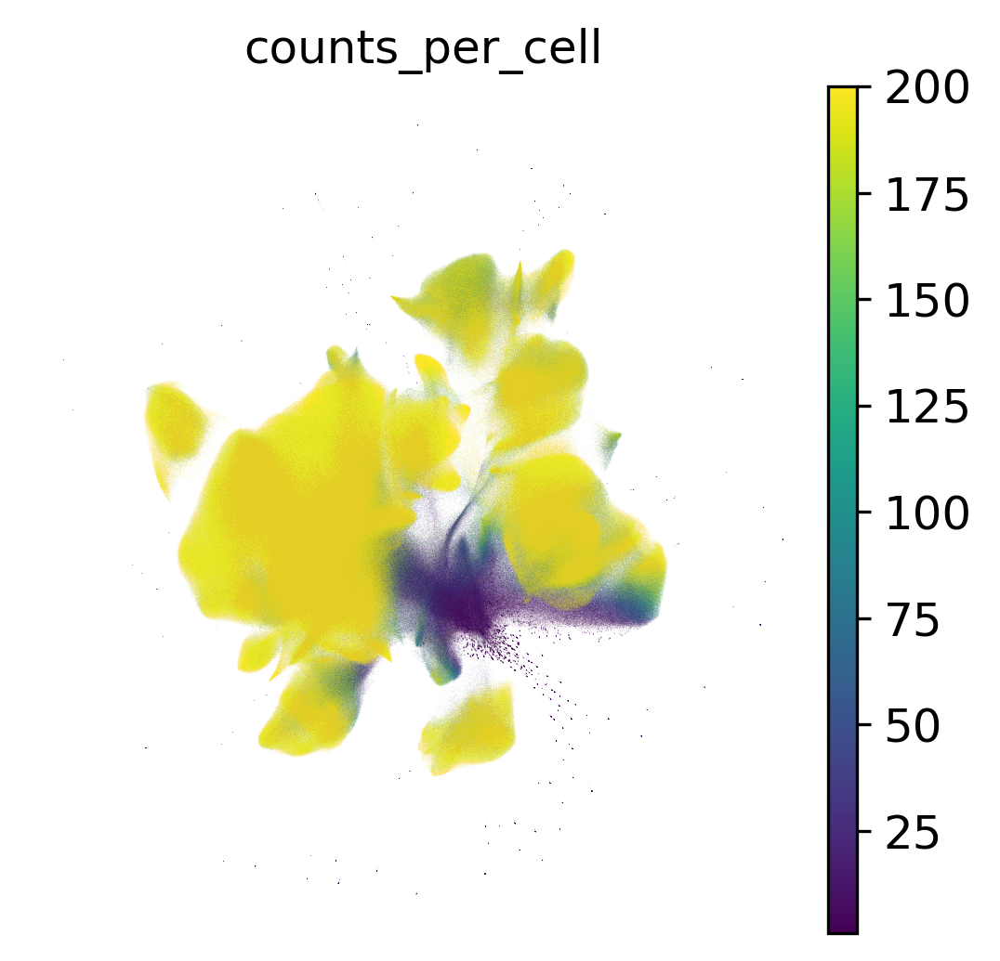

In [37]:
sc.pl.umap(
    adata,
    color=["counts_per_cell"],
    wspace=0.5,
    hspace=0.5,
    ncols=1,
    vmax=200,
    # groups=["T cell", "T cell low-quality"],
    # palette=cc.glasbey_dark,
    show=False,
    use_raw=False,
    frameon=False,
)
# plt.savefig(f"{figure_dir}/nicheVI_umap_counts_per_cell.svg", dpi=300)

In [38]:
adata_T_cell = ad.read_h5ad(path_to_save + "/pancancer_resolvi_nicheVI_T_Cell.h5ad")

adata.obs["leiden_T_Cell_0.5"] = "Unknown"
adata.obs.loc[adata_T_cell.obs.index, "leiden_T_Cell_0.5"] = (
    adata_T_cell.obs["leiden_T_Cell_0.5"]
)

<Axes: title={'center': 'leiden_T_Cell_0.5'}, xlabel='UMAP1', ylabel='UMAP2'>

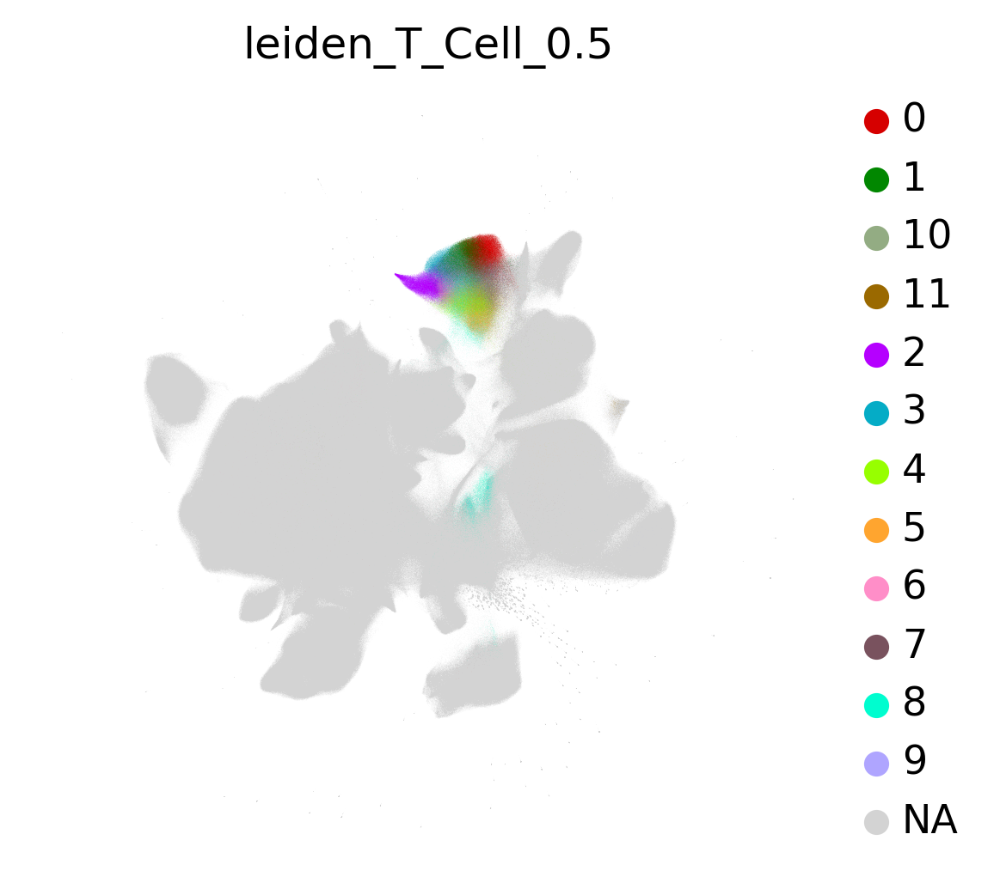

In [39]:
sc.pl.umap(
    adata,
    color=["leiden_T_Cell_0.5"],
    wspace=0.5,
    hspace=0.5,
    ncols=1,
    vmax=200,
    # groups=["T cell", "T cell low-quality"],
    groups=["0", "1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11"],
    # groups = ["0", "1", "2", "3", "6"],
    palette=cc.glasbey_light,
    show=False,
    use_raw=False,
    frameon=False,
)

# plt.savefig(f"{figure_dir}/nicheVI_umap_leiden.svg", dpi=300)

/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


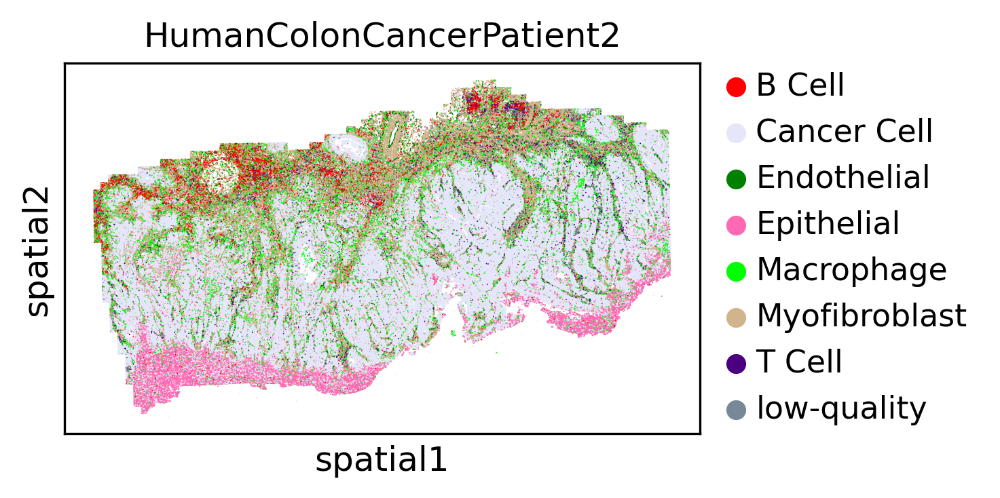

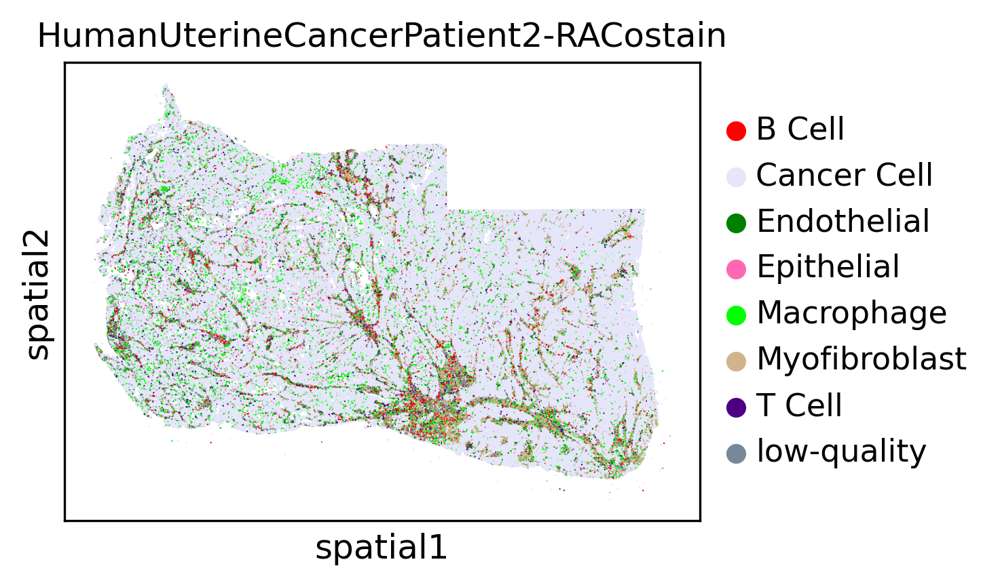

In [40]:
samples_to_consider = (
    [
        # "HumanLiverCancerPatient1",
        "HumanColonCancerPatient2",
        # "HumanBreastCancerPatient1",
    ]
    + [
        "HumanUterineCancerPatient2-RACostain",
        # "HumanUterineCancerPatient2-ROCostain",
        # "HumanUterineCancerPatient1",
    ]
    # + 
    # ["HumanLungCancerPatient2"]
)


for sample in samples_to_consider:
    # adata_sample = adata[adata.obs[setup.SAMPLE].isin([samples])].copy()
    sc.pl.spatial(
        adata[adata.obs[setup.SAMPLE] == sample],
        spot_size=35,
        color="celltype_coarse",
        ncols=2,
        title=sample,
        wspace=0.3,
        # palette=cc.glasbey_light,
        palette=colors,
        # groups=["T Cell", "low-quality"],
        show=False,
    )
    # plt.savefig(f"{figure_dir}/{sample}_spatial_cell_types.svg", dpi=500)

uterine

/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


lung

/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


prostate

/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


colon

/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


ovarian

/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


melanoma

/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


breast

/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


liver

/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
/home/nathanl/miniforge3/envs/scvi/lib/python3.12/site-packages/scanpy/plotting/_utils.py:487: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


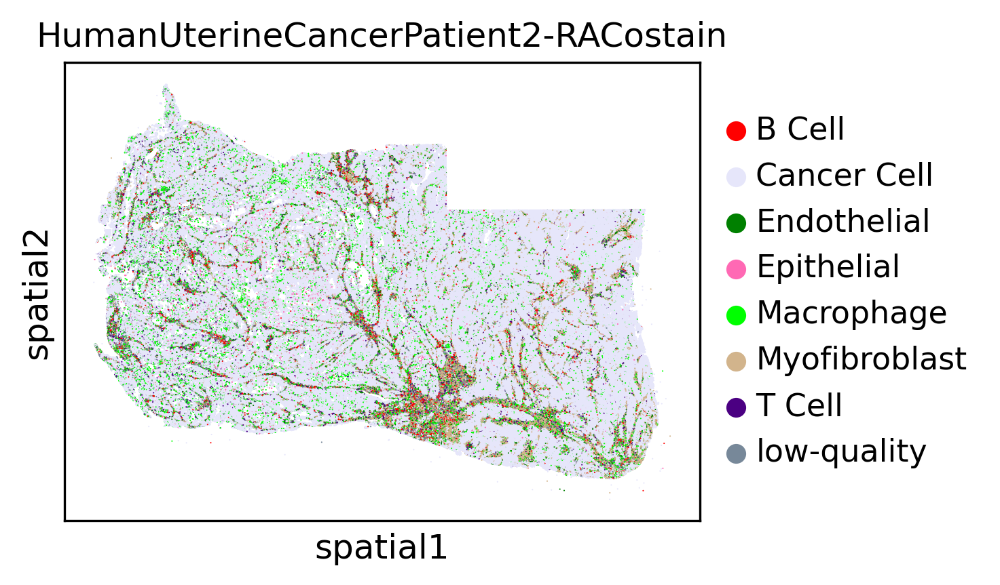

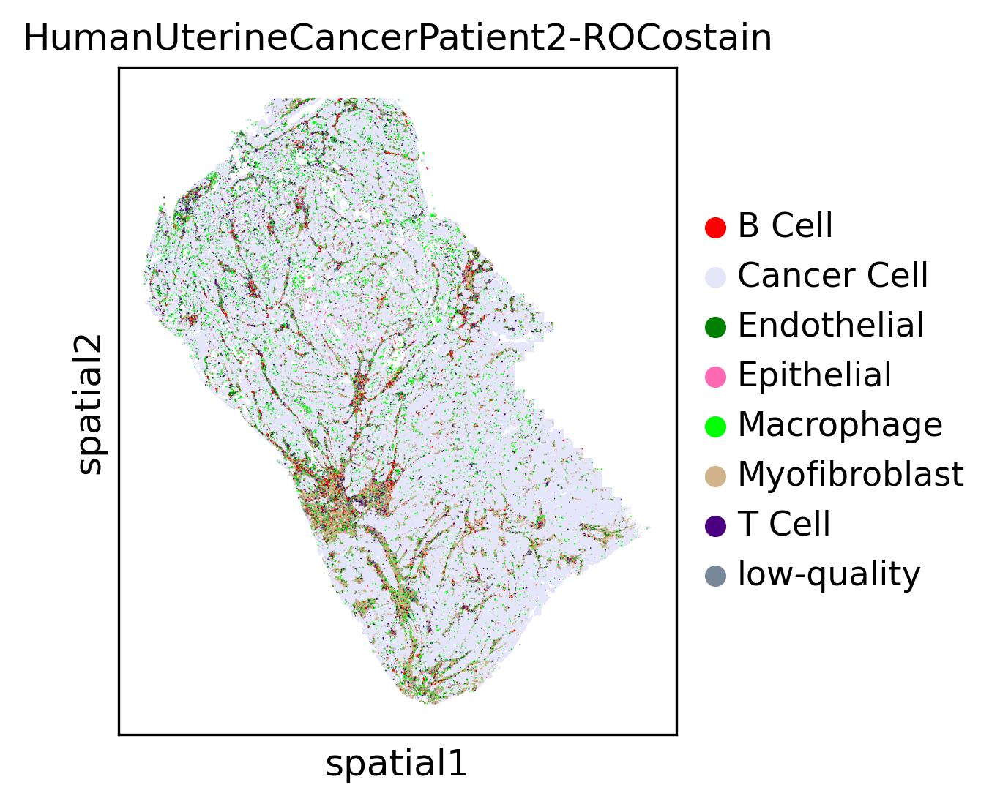

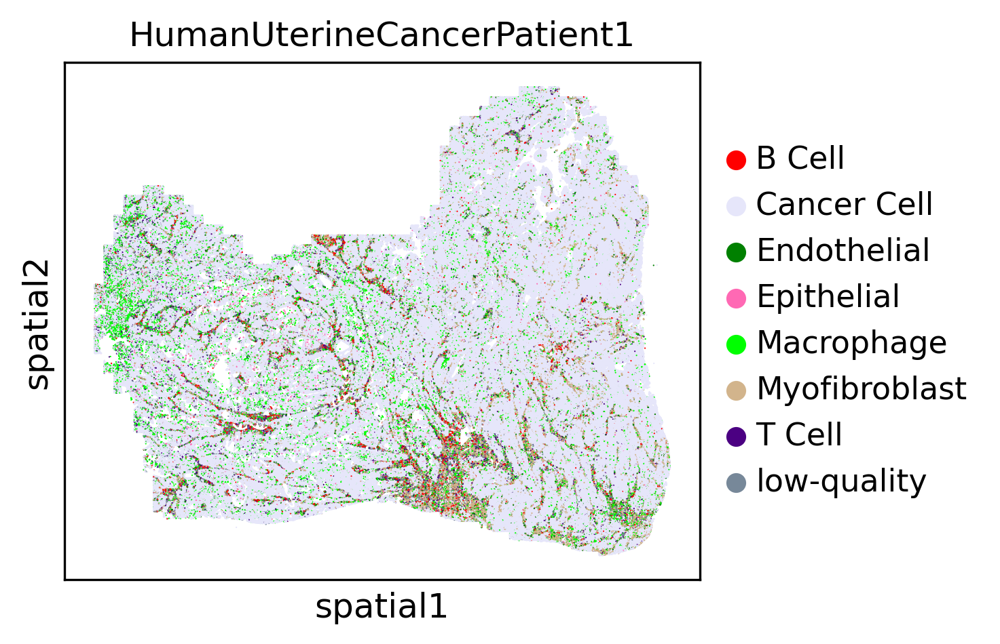

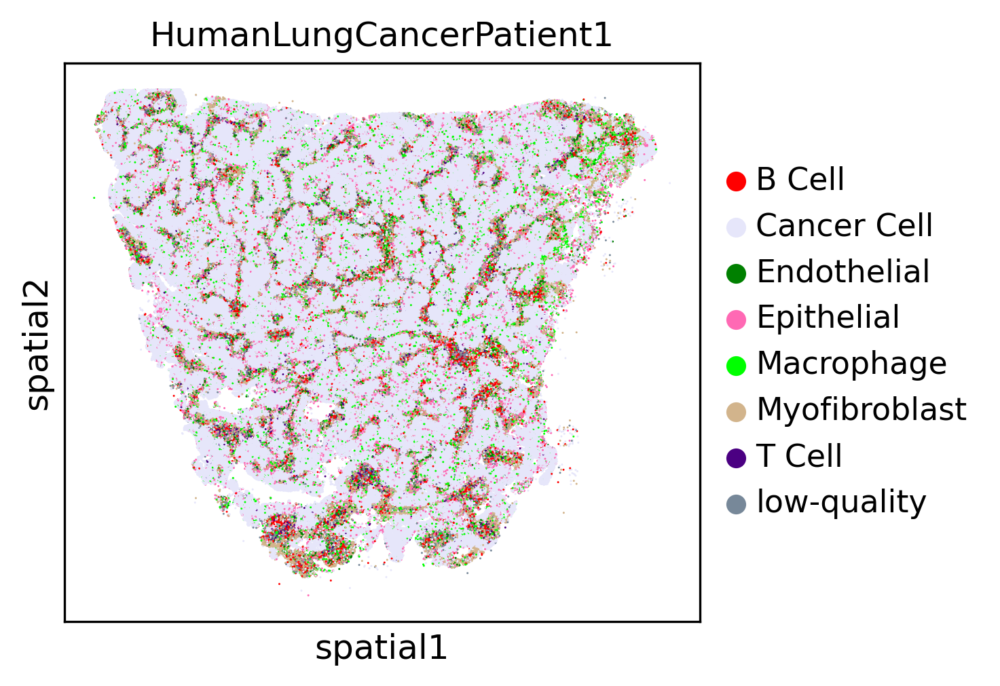

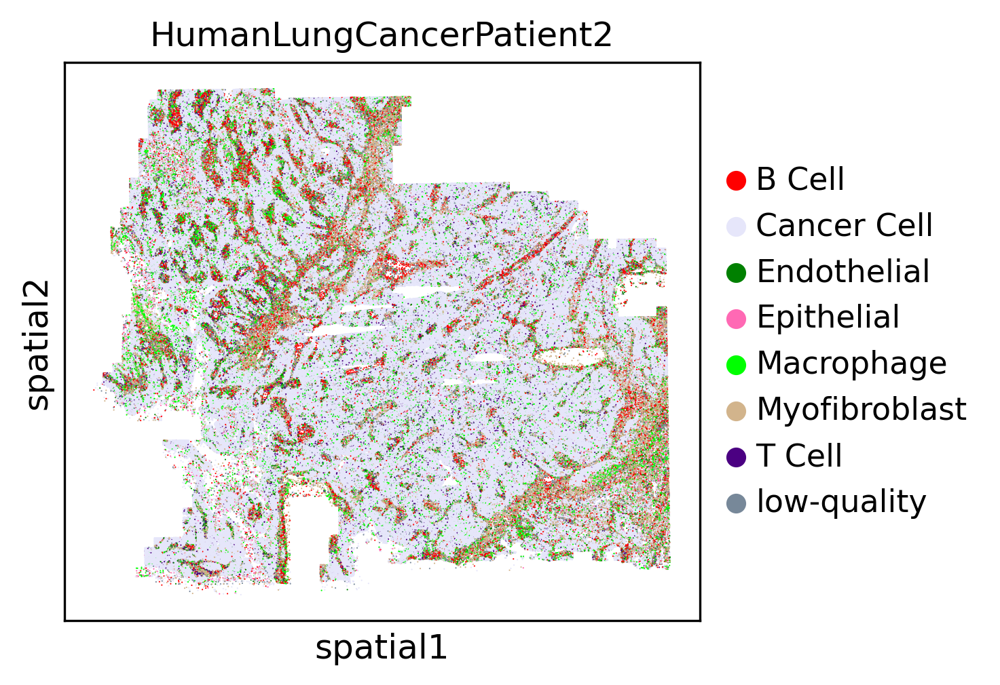

...

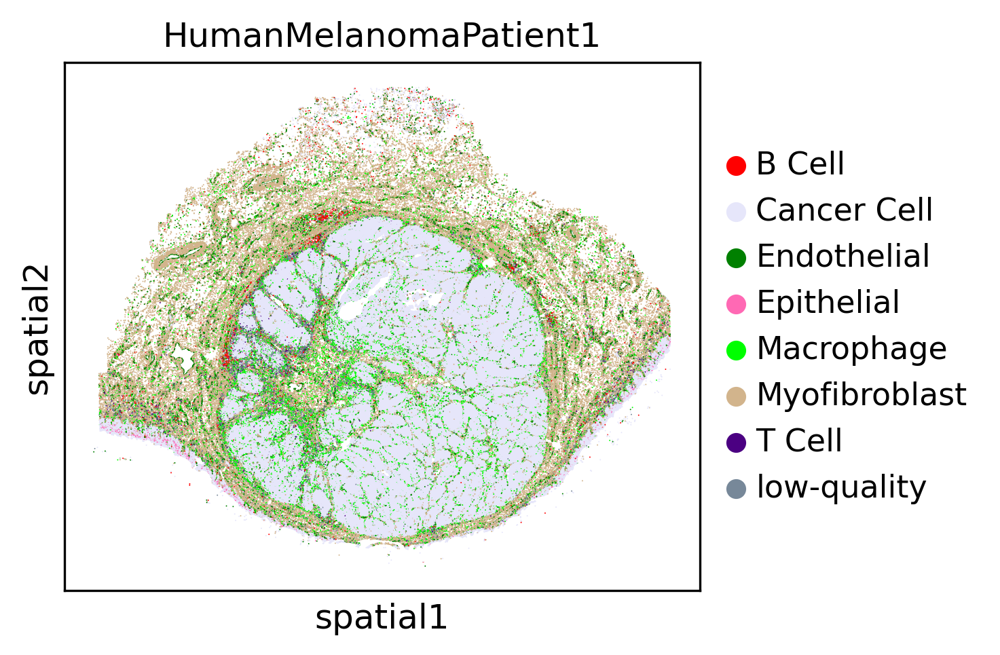

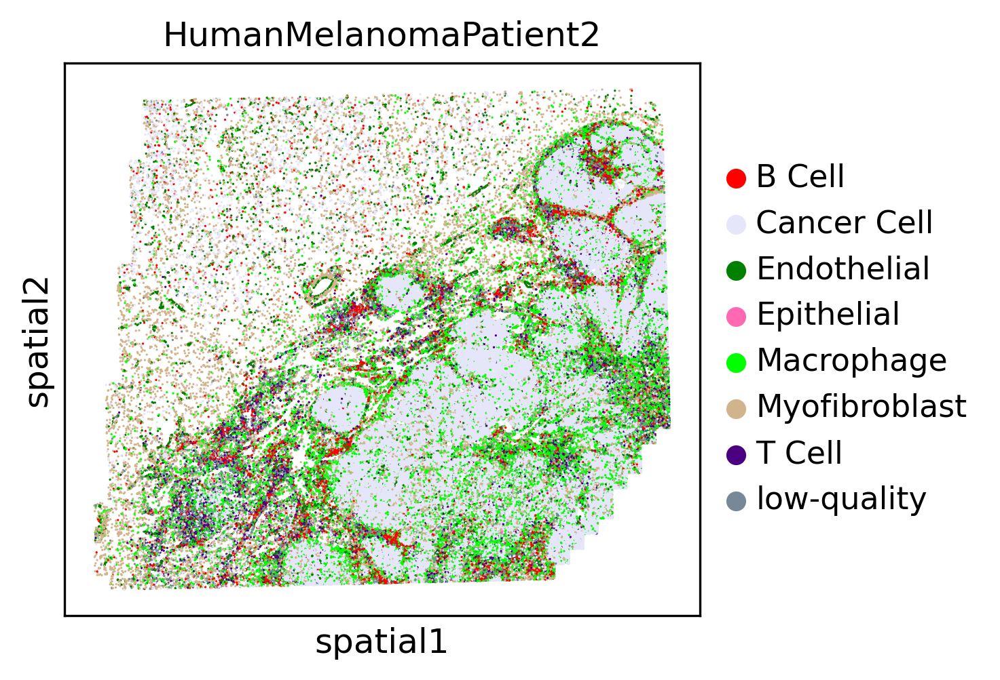

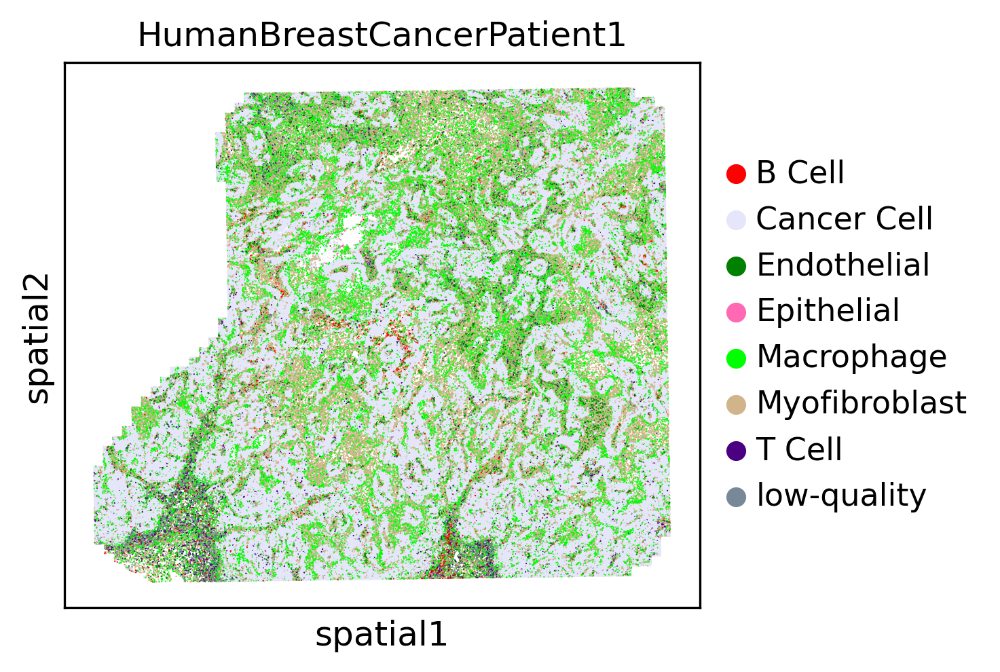

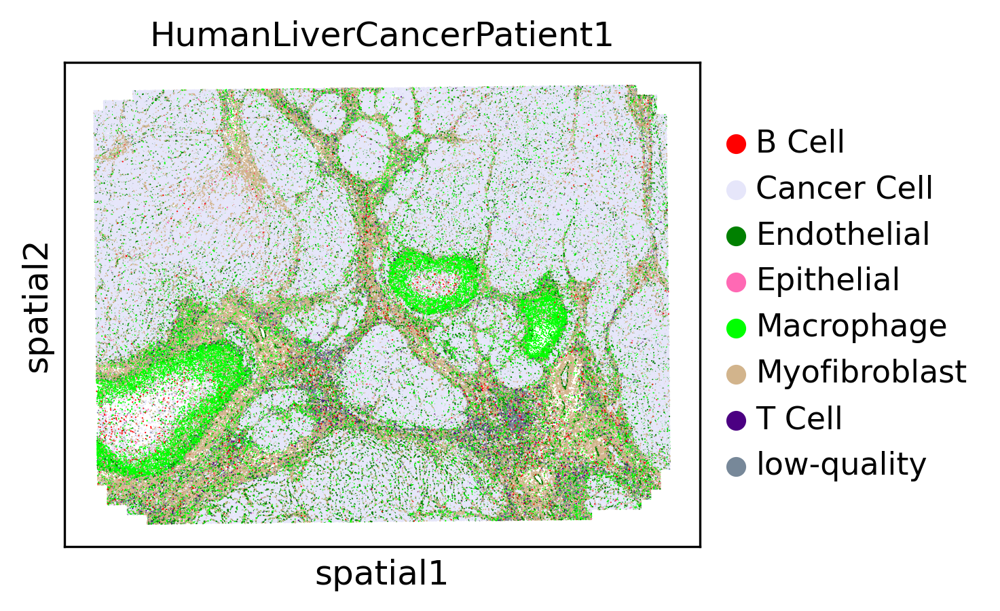

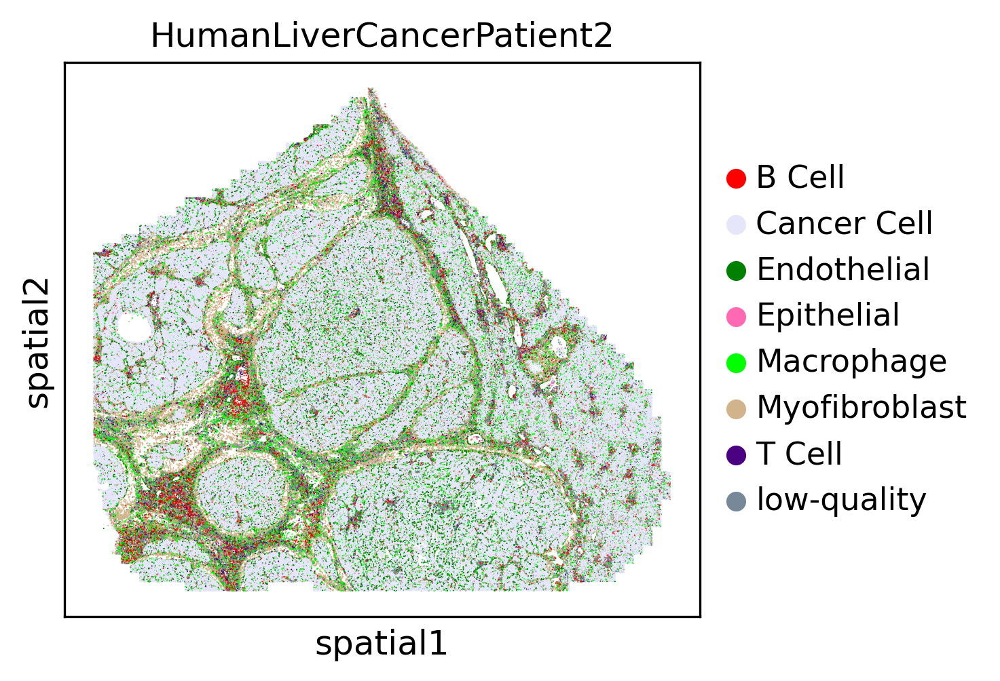

In [41]:
for organ, samples in samples_organs.items():
    print(organ)
    adata_sample = adata[adata.obs[setup.SAMPLE].isin(samples)].copy()
    for sample in samples:
        sc.pl.spatial(
            adata_sample[adata_sample.obs[setup.SAMPLE] == sample],
            spot_size=30,
            # color=setup.CELL_TYPE,
            color="celltype_coarse",
            ncols=2,
            title=sample,
            wspace=0.3,
            # palette=cc.glasbey_light,
            palette=colors,
            show=False,
        )
        # plt.savefig(f"{figure_dir}/{sample}_spatial_cell_types.png", dpi=500)